# Fusion Hub Data Quick-Start

This notebook demonstrates the process of:
* Printing the available collections of Fusion Hub data
* Searching a collection to intersect a point location between a start data and end date
* Converting the search result to an `xarray` DataArray
* Subsetting the DataArray to a geometry
* Plotting the time series in a grid
* Extracting data from a point location
* Reducing the data within a geometry
* Downloading a file based on valid data percentage
* Downloading multiple files
* Removing data entries based on some condition
* Creating matplotlib animations

In [1]:
import json
import requests
import pystac
from pystac_client import Client
from pprint import pprint

from botocore.exceptions import ClientError
from shapely.geometry import box, mapping, Point, Polygon
from pyproj.crs import CRS
import geopandas as gpd

import xarray as xr
import rioxarray as rxr
import rasterio as rio

from matplotlib import pyplot as plt
import numpy as np

import os

In [2]:
with open('stac-token.txt') as f:
    accesstoken = f.readlines()[0].strip('\n')  

cat_url = 'https://fusion-stac.hydrosat.com'
catalog = Client.open(cat_url, headers={'Authorization':'Bearer ' + accesstoken})
collections = catalog.get_children()
for collection in collections:
    print(f"{collection.id} - {collection.title}")

pydms_sharpened_ecostress - Sharpened LST using Sentinel-2 and ECOSTRESS
prepped_inputs_s2 - Sentinel-2 Surface Reflectance
prepped_inputs_ecostress - ECOSTRESS Land Surface Temperature
prepped_inputs_lc08 - Landsat-8 Surface Temperature
pydms_sharpened_modis - Sharpened LST using MODIS surface reflectance and LST
prepped_inputs_vnp43ma4 - VIIRS Surface Reflectance VNP43MA4
starfm_predictions_modis_ecostress - Predicted LST using MODIS and LC08
prepped_inputs_mcd43a4 - MODIS Surface Reflectance MCD43
starfm_predictions_viirs_ecostress - Predicted LST using MODIS and LC08
prepped_inputs_mod21a1d - MODIS Land Surface Temperature MOD21
starfm_predictions_viirs_lc08 - Predicted LST using MODIS and LC08
starfm_predictions_modis_lc08 - Predicted LST using MODIS and LC08
prepped_inputs_vnp21a1d - VIIRS Land Surface Temperature VNP21
pydms_sharpened_lc08 - Sharpened LST using Sentinel-2 and LC08
pydms_sharpened_viirs - Sharpened LST using VIIRS surface reflectance and LST


We'll search for data in the `pydms_sharpened_lc08` collection which intersects a point location between a start date and an end date and print out the number of items.

In [3]:
geom = {'type': 'Point', 'coordinates': [-120.21102905273436,36.535019209789]} # Point for Hanford, CA, USA

endpoint = 'https://fusion-stac.hydrosat.com'
catalog = Client.open(endpoint, headers={'Authorization':'Bearer ' + accesstoken})
search = catalog.search(
    collections = "starfm_predictions_modis_lc08",
    intersects = geom,
    datetime = ["2021-05-11T00:00:00Z","2021-10-30T00:00:00Z"],
    max_items = 500
)

items = search.get_all_items()
len(items)

64

Now we'll pass the items to the `FH_Hydrosat` class and stack the items into an `xarray` `DataArray`. We'll print out the DataArray to get a summary of its contents.

In [4]:
from FH_Hydrosat import FH_Hydrosat
res = FH_Hydrosat(items)
stacked_res = res.stack()
stacked_res.ds

<xarray.DataArray (time: 64, band: 1, y: 5490, x: 5490)>
dask.array<xarray-<this-array>, shape=(64, 1, 5490, 5490), dtype=float32, chunksize=(64, 1, 2048, 2048), chunktype=numpy.ndarray>
Coordinates:
  * band         (band) int64 1
  * x            (x) float64 7e+05 7e+05 7e+05 ... 8.097e+05 8.097e+05 8.098e+05
  * y            (y) float64 4.1e+06 4.1e+06 4.1e+06 ... 3.99e+06 3.99e+06
    spatial_ref  int64 0
  * time         (time) object 2021-07-13T00:00:00+00:00 ... 2021-05-11T00:00...
Attributes:
    scale_factor:  1.0
    add_offset:    0.0

In [5]:
ds = stacked_res.ds

The `DataArray` is quite large if we try to access all of the data. For ease of computation, we'll subset the `DataArray` by a polygon, which will be generated by creating a rectangular buffer around the point location by 1km on either side.

In [6]:
p_geom = Point(geom['coordinates'][0], geom['coordinates'][1])
point_df = gpd.GeoDataFrame({'geometry':[p_geom]}, crs=CRS.from_epsg(4326))

In [7]:
raster_crs = CRS.from_wkt(ds.spatial_ref.crs_wkt)
buffer_dist = 1000 # 1km in local UTM zone
poly_df = point_df.to_crs(raster_crs).buffer(buffer_dist, cap_style = 3) # square buffer


Let's plot the polygon on a Folium map so we can see where we are extracting the data

In [8]:
import folium 

# Use WGS 84 (epsg:4326) as the geographic coordinate system
df = gpd.GeoDataFrame(poly_df.to_crs(epsg=4326))

m = folium.Map(location=[p_geom.y, p_geom.x], zoom_start=13, tiles='CartoDB positron')

# add the polygon and centroid
for _, r in df.iterrows():
    # Without simplifying the representation of each polygon,
    # the map might not be displayed
    #sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    sim_geo = r[0].simplify(tolerance=0.001)
    geo_j = gpd.GeoSeries(sim_geo).to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    
    geo_j.add_to(m)
    
    lat = sim_geo.centroid.y
    lon = sim_geo.centroid.x
    folium.Marker(location=[lat, lon]).add_to(m)
    
m

Now let's clip the dataset with the geometry using `rioxarray`'s `rio` utility package

In [9]:
from FH_Hydrosat import FH_StackedDataset

# clip the raster dataset and cast to a class with slightly more functions
clipped = FH_StackedDataset(ds.rio.clip(poly_df.geometry))
ds_clip = clipped.ds

Now that we have a smaller `DataArray`, let's plot the contents according to the `time` dimension using `xarray`'s plot utility.

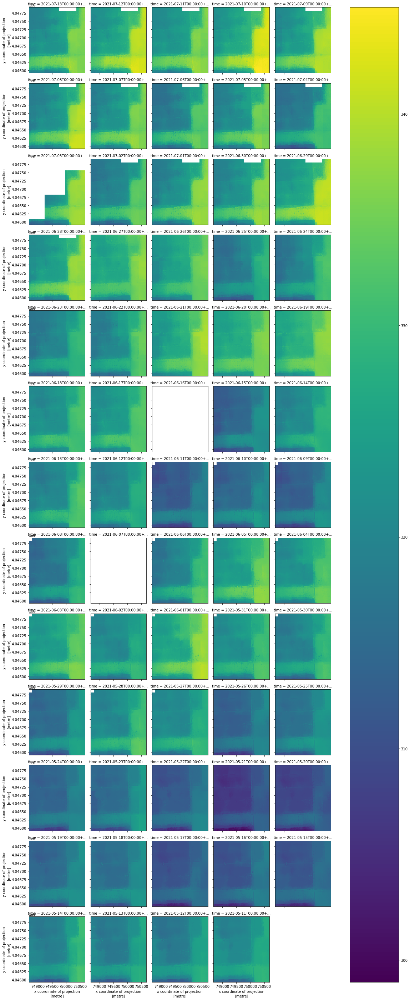

In [10]:
ds_clip.plot(x='x', y='y', col='time', col_wrap=5);

## Plot a time series for the point location

With the same `DataArray`, we can extract the pixel values which intersect a point location. Let's use the same point location we used to search the STAC catalog and plot it.

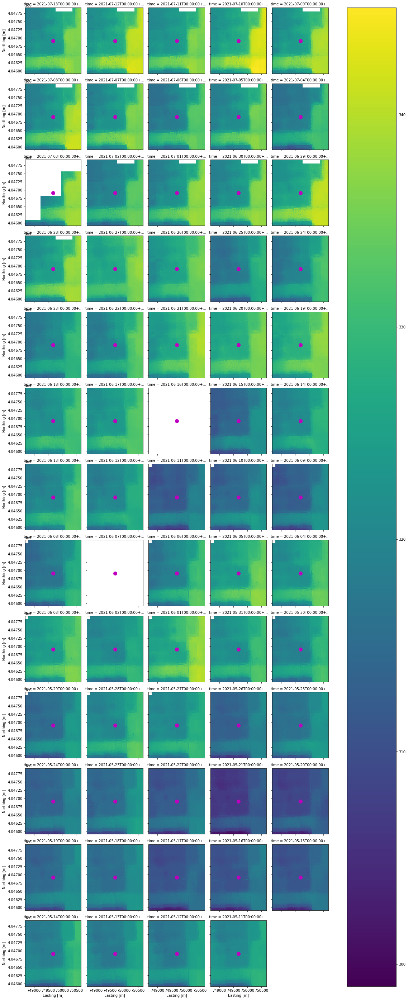

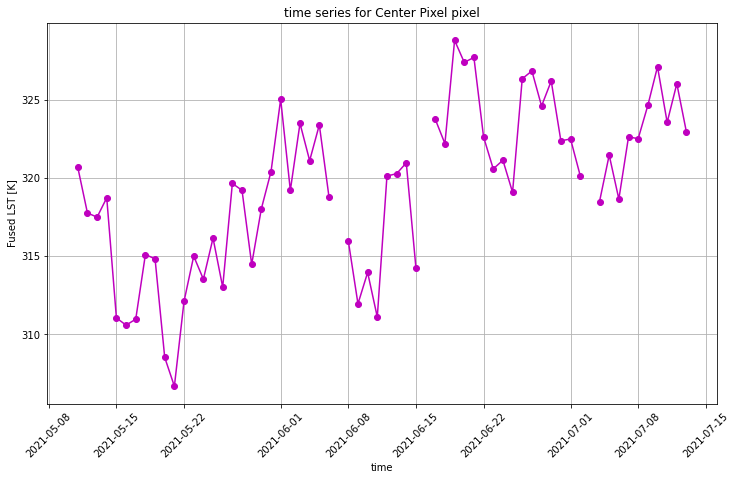

In [23]:
centroid = poly_df.geometry[0].centroid
set_x, set_y, pixtype = (centroid.x, centroid.y, 'Center Pixel') # change 'Center Pixel' for plot title

ax = ds_clip.plot(x='x', y='y', col='time', col_wrap=5)
ax.set_xlabels('Easting [m]')
ax.set_ylabels('Northing [m]')
ax.map(lambda: plt.plot(set_x, set_y, markersize=20, marker=".", color="m"))
plt.show()


ax = ds_clip.isel(band=0).sel(x=set_x, y=set_y, method='nearest', tolerance=20).plot(marker='o', c='m', figsize=(12,7))
plt.title(f'time series for {pixtype} pixel')
plt.grid(True)
plt.ylabel('Fused LST [K]')
plt.xticks(rotation=45)
plt.show()

Similarly, we can reduce the area within the subsetting geometry to the mean value, and plot against the time series for the point location.

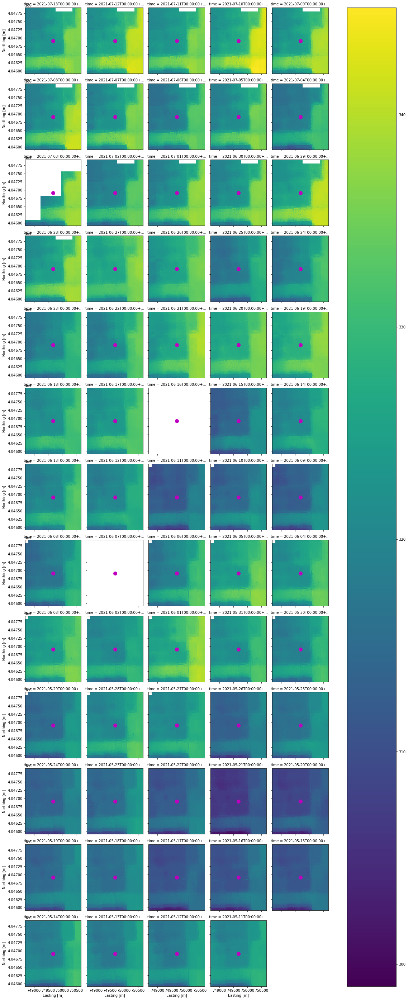

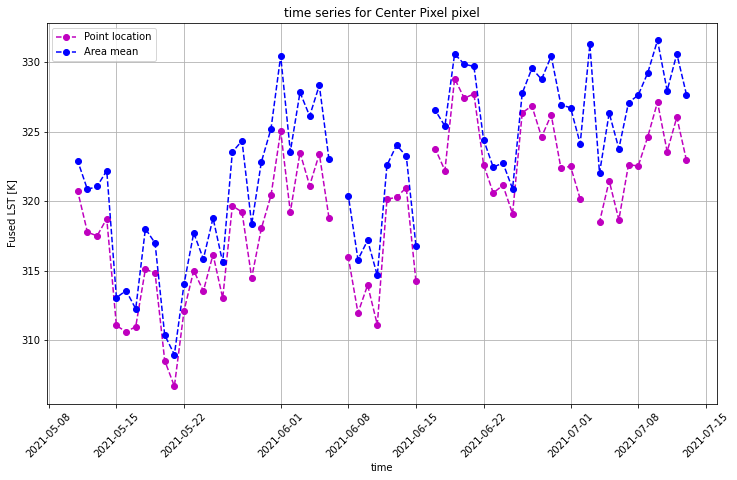

In [24]:
ax = ds_clip.plot(x='x', y='y', col='time', col_wrap=5)
ax.set_xlabels('Easting [m]')
ax.set_ylabels('Northing [m]')
ax.map(lambda: plt.plot(set_x, set_y, markersize=20, marker=".", color="m"))
plt.show()


ax = ds_clip.isel(band=0).sel(x=set_x, y=set_y, method='nearest', tolerance=20).plot(linestyle='--', marker='o', c='m', label='Point location', figsize=(12,7))
ax = ds_clip.isel(band=0).mean(dim=('x', 'y')).plot(linestyle='--', marker='o', c='b', label='Area mean')
plt.title(f'time series for {pixtype} pixel')
plt.legend()
plt.grid(True)
plt.ylabel('Fused LST [K]')
plt.xticks(rotation=45)
plt.show()

## download a single file

In [13]:
# find which file has the most data in it
max_data_idx = np.argmax(ds_clip.count(dim=('x', 'y', 'band')).values)

outfile = f'./{os.path.basename(res.item_desc[max_data_idx])}'
print(outfile, os.path.exists(outfile))

res.download_single_asset(max_data_idx)

print(outfile, os.path.exists(outfile))

./10SGF_pred_2021178_from_2021162_using_MODIS_LC08 False
./10SGF_pred_2021178_from_2021162_using_MODIS_LC08 True


## download multiple files, since there a few scenes that have full coverage for the AOI

In [14]:
# download the items above which correspond to items 2,5,6, and 10
# using the download_multiple_assets() function
res.download_multiple_assets([2,5,6,10])

using 2 processes to download 4 assets


## make an animation from the full set of data

In [15]:
from IPython.display import HTML
%matplotlib notebook

In [16]:
# use the create_animation() function.
# display the animation with HTML display
ani = clipped.create_animation(save_ani=True, vmin=300, vmax=350)
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

MovieWriter ffmpeg unavailable; using Pillow instead.


### drop files with data less than 50% coverage
Sometimes the data will have low coverage due to cloud cover or invalid pixels in the input data products. Let's remove them from the dataset using the `remove_below_data_perc()` function, plot them, and create an animation.

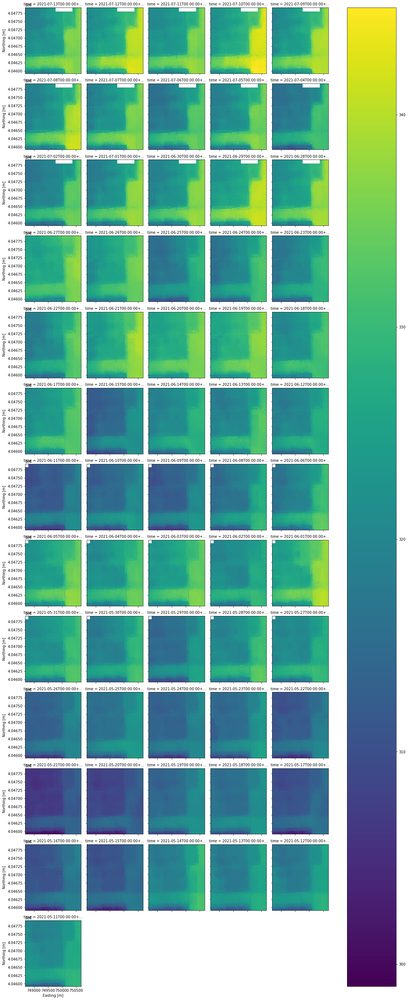

In [22]:
# to switch back and allow xarray plots
%matplotlib inline 

more_data = FH_StackedDataset(clipped.remove_below_data_perc(clipped.ds, 0.5))
ax = more_data.ds.plot(x='x', y='y', col='time', col_wrap=5)
ax.set_xlabels('Easting [m]')
ax.set_ylabels('Northing [m]')
plt.show()

In [18]:
 # switch back to allow animation
%matplotlib notebook
ani = more_data.create_animation(save_ani=True, vmin=300, vmax=350, anipath='more_data.gif')
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

MovieWriter ffmpeg unavailable; using Pillow instead.


You may notice that the animation plays with the most recent date in the data stack first, and then descending. To reverse the order to ascending, use an `xarray` call to reverse the `time` dimension on the dataset.

In [19]:
# reverse the order
more_data_rev = FH_StackedDataset(more_data.ds.reindex(time=list(reversed(more_data.ds.time.values))))
ani = more_data_rev.create_animation(save_ani=True, vmin=300, vmax=350, anipath='more_data_rev.gif')
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

MovieWriter ffmpeg unavailable; using Pillow instead.
